<a href="https://colab.research.google.com/github/datakind/Viamo_DataDive_Dec22/blob/main/Workstream%20%232/Viamo_Workstream2_Mali_EveT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##**Please open in Colab to view the graphs. Thank you**

##**Install and import packages**

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px
import matplotlib.dates as mdates
import numpy as np

In [ ]:
!pip install google-cloud
!pip install google-cloud-bigquery[pandas]
!pip install google-cloud-storage
!pip install pandas-gbq -U

In [ ]:
from google.cloud import bigquery

##**Initial setup**

I'm going to randomly extract only 100,000 rows for organization_country equal to 'Mali'. Only columns that are deemed relevant will be extracted here. 

In [ ]:
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = 'viamo-datakind-19b12e3872f5.json'

Bigquery_client = bigquery.Client()

df = pd.read_gbq("SELECT call_id, call_date, subscriber_id, call_started, call_ended, region, region_name, age, gender, location, location_level_2, subscriber_pereferred_language, rural_or_urban, phone_type, education_level, income_source, highest_expense_area, duration_listened_minutes, duration_listened_seconds, block_title, block_theme, block_topic FROM `viamo-datakind.datadive.321_sessions_1122` WHERE organization_country='Mali' ORDER BY RAND() LIMIT 100000")

##**Take a quick look at the data: EDA and some data cleaning**

###**First 5 rows**

It seems like there's a mispelled column [subscriber_pereferred_language], where 'preferred' is spelled wrongly. Not a big deal though

In [ ]:
df.head()

,call_id,call_date,subscriber_id,call_started,call_ended,region,region_name,age,gender,location,...,rural_or_urban,phone_type,education_level,income_source,highest_expense_area,duration_listened_minutes,duration_listened_seconds,block_title,block_theme,block_topic
0,1309833640947541204,2021-11-23,1003372800230612992,2021-11-23 10:51:15+00:00,2021-11-23 10:51:55+00:00,FWA,Francophone West Africa,over_44,male,Segou,...,None,None,None,None,None,0.0,0.0,None,,
1,1294603690992787780,2021-10-12,1240259587102794424,2021-10-12 10:12:52+00:00,2021-10-12 10:34:22+00:00,FWA,Francophone West Africa,under_18,female,Sikasso,...,None,None,None,None,None,0.3,15.0,Mosquito nets are to be used all year round,health,"coronavirus,malaria"
2,1241457895032807916,2021-05-18,1077326003153985536,2021-05-18 18:30:27+00:00,2021-05-18 18:30:34+00:00,FWA,Francophone West Africa,25_34,male,Kayes,...,None,None,None,None,None,0.1,7.0,Digest or main menu?,,
3,1196225677276800020,2021-01-13,1161013947982733312,2021-01-13 22:53:46+00:00,2021-01-13 23:06:46+00:00,FWA,Francophone West Africa,over_44,female,Kayes,...,None,None,None,None,None,0.0,2.0,Choix Menu Tamani,news,
4,1290352438930891672,2021-09-30,1099777518686756864,2021-09-30 16:39:55+00:00,2021-09-30 16:41:34+00:00,FWA,Francophone West Africa,18_24,male,Gao,...,None,None,None,None,None,0.1,5.0,Hand washing,health,"coronavirus,malaria"


###**Missing data**

In [ ]:
df.isnull().sum()

call_id                                0
call_date                              0
subscriber_id                          0
call_started                           0
call_ended                             0
region                                 0
region_name                            0
age                                25912
gender                             14833
location                           17545
location_level_2                   35024
subscriber_pereferred_language       585
rural_or_urban                    100000
phone_type                        100000
education_level                   100000
income_source                     100000
highest_expense_area              100000
duration_listened_minutes            995
duration_listened_seconds            995
block_title                        17775
block_theme                            0
block_topic                            0
dtype: int64

We can see that all the rows extracted don't have values for these columns: [rural_or_urban], [phone_type], [education_level], [income_source], and [highest_expense_area]. I am going to remove these columns.

In [ ]:
df = df.drop(columns=['rural_or_urban', 'phone_type', 'education_level', 'income_source', 'highest_expense_area'])
df.isnull().sum()

call_id                               0
call_date                             0
subscriber_id                         0
call_started                          0
call_ended                            0
region                                0
region_name                           0
age                               25912
gender                            14833
location                          17545
location_level_2                  35024
subscriber_pereferred_language      585
duration_listened_minutes           995
duration_listened_seconds           995
block_title                       17775
block_theme                           0
block_topic                           0
dtype: int64

In [ ]:
df.block_title.value_counts()

Digest or main menu?                                                           14997
Main Menu                                                                       8183
Choix Menu Tamani                                                               7005
Titres du Journal                                                               6571
Digest Intro                                                                    4965
                                                                               ...  
4.4.1.DEFINITION D'ATTAQUES DANS LE DOMAINE SCOLAIRE                               1
Q.11.6                                                                             1
z14En cas de morsure                                                               1
Comment choisir le crédit adapté : Cas d’un crédit inadapté à ses besoins ?        1
Msg2.2.2. avantages de la mise au sein précoce pour la mère                        1
Name: block_title, Length: 1069, dtype: int64

In [ ]:
df.block_theme.value_counts()

                    55964
news                26051
health               7227
financial            1912
health,nutrition     1778
ed                   1417
security             1406
gender               1185
financial,rights     1181
rights               1031
ag                    563
games                 284
nutrition               1
Name: block_theme, dtype: int64

In [ ]:
df.block_topic.value_counts()

                           92983
coronavirus,malaria         3676
coronavirus                 2121
livestock                    402
malaria                      329
gbv                          179
coronavirus,malaria,ncd      170
malaria,ncd                  115
maternal                      21
environment                    3
coronavirus,ncd                1
Name: block_topic, dtype: int64

[block_theme] and [block_topic] have empty strings as values which are not caught by the isnull() function.

Since I'm only going to visualize this data and not run some machine learning algorithm on it, I feel like it's ok to have some null data in some of these columns, so I will keep them for now.

###**Outliers**

In [ ]:
df.describe()

,call_id,subscriber_id,duration_listened_minutes,duration_listened_seconds
count,1.000000e+05,1.000000e+05,99005.000000,99005.000000
mean,2.032959e+12,4.028211e+12,0.964341,57.820534
std,6.944397e+16,1.342153e+17,2.313689,138.784364
min,1.191541e+18,7.322053e+17,0.000000,0.000000
25%,1.254545e+18,1.017491e+18,0.000000,2.000000
50%,1.311649e+18,1.113566e+18,0.200000,14.000000
75%,1.369015e+18,1.259149e+18,0.900000,53.000000
max,1.441572e+18,1.441404e+18,45.500000,2727.000000


Someone listened for 45.5 minutes but the third quartile is only 0.9 minutes. 

Again, since I'm only going to visualize this data and not run some machine learning algorithm on it so I'm going to keep these potential outliers for now.

###**Repetitive or uninformative data**

In [ ]:
df[['region', 'region_name']].apply(pd.Series.value_counts)

,region,region_name
FWA,100000.0,NaN
Francophone West Africa,NaN,100000.0


It seems like all the values in the [region] and [region_name] columns are the same respectively, so I will remove these columns.

In [ ]:
df = df.drop(columns=['region', 'region_name'])

In [ ]:
df['location'].value_counts()

Sikasso       21052
Segou         14937
Kayes         13404
Koulikoro     10486
Mopti          8657
Bamako         5480
Tombouctou     3877
Kidal          2405
Gao            2141
Ségou             4
Kati              2
Kenieba           1
Kignan            1
Bandiagara        1
Banamba           1
Bankass           1
San               1
Markala           1
Bougouni          1
Kita              1
SÃ©gou            1
Name: location, dtype: int64

In [ ]:
df['location_level_2'].value_counts()

Cercle de Bougouni          6454
Cercle de Kadiolo           3925
Cercle de Barouéli          3492
Cercle de Koutiala          3004
Cercle de Bafoulabé         2979
Cercle de Bla               2878
Cercle de Kéniéba           2726
Cercle de Diéma             2557
Cercle de Dioïla            2405
Cercle de Banamba           2283
Cercle de Sikasso           2214
Cercle de Bandiagara        2154
Cercle de Macina            1854
Cercle de Bankass           1564
Cercle de Niono             1499
Cercle de Ségou             1383
Cercle de Kita              1251
Cercle de Goundam           1216
Cercle de Djenné            1147
Cercle de Kayes             1120
Cercle de Kangaba           1066
Cercle de Kati              1008
Cercle de San                999
Cercle de Kolondiéba         882
Cercle de Gao                842
Cercle de Mopti              822
Cercle de Koulikoro          791
Cercle de Kidal              769
Cercle de Kolokani           764
Cercle de Yorosso            755
Cercle de 

In [ ]:
df['subscriber_pereferred_language'].value_counts()

Bambara     70127
Fula        13239
Tamasheq     6802
Songhay      5274
French       3973
Name: subscriber_pereferred_language, dtype: int64

[location], [location_level_2], and [subscriber_pereferred_language] look ok.

###**Duplicates**

Let's remove any duplicate rows.

In [ ]:
df[df.duplicated()]

,call_id,call_date,subscriber_id,call_started,call_ended,age,gender,location,location_level_2,subscriber_pereferred_language,duration_listened_minutes,duration_listened_seconds,block_title,block_theme,block_topic
69780,1338311577459810876,2022-02-10,1332010390334792728,2022-02-10 00:52:24+00:00,2022-02-10 02:59:23+00:00,18_24,male,Sikasso,None,Tamasheq,2.2,130.0,Digest or main menu?,,
78731,1332509803759067740,2022-01-25,1264493968478496608,2022-01-25 00:38:14+00:00,2022-01-25 01:59:11+00:00,18_24,male,Sikasso,Cercle de Kadiolo,Bambara,1.4,86.0,Faire un Budget,"financial,rights",
94340,1262402621290376808,2021-07-15,1218907469553134208,2021-07-15 13:37:19+00:00,2021-07-15 13:46:03+00:00,over_44,male,Sikasso,Cercle de Bougouni,Fula,0.0,0.0,None,,


It seems like these 3 rows have duplicates somewhere in the dataframe. I'm going to remove their duplicates.

In [ ]:
df = df.drop_duplicates()
df.shape

(99997, 15)

###**Data types**

In [ ]:
df.dtypes

call_id                                         Int64
call_date                                      dbdate
subscriber_id                                   Int64
call_started                      datetime64[ns, UTC]
call_ended                        datetime64[ns, UTC]
age                                            object
gender                                         object
location                                       object
location_level_2                               object
subscriber_pereferred_language                 object
duration_listened_minutes                     float64
duration_listened_seconds                     float64
block_title                                    object
block_theme                                    object
block_topic                                    object
dtype: object

Matplotlib needs the date to be in datetime64[ns]. Change the call_date column's data type to datetime64[ns].

In [ ]:
df.call_date = pd.to_datetime(df.call_date, format="%Y-%m-%d")

In [ ]:
df.dtypes

call_id                                         Int64
call_date                              datetime64[ns]
subscriber_id                                   Int64
call_started                      datetime64[ns, UTC]
call_ended                        datetime64[ns, UTC]
age                                            object
gender                                         object
location                                       object
location_level_2                               object
subscriber_pereferred_language                 object
duration_listened_minutes                     float64
duration_listened_seconds                     float64
block_title                                    object
block_theme                                    object
block_topic                                    object
dtype: object

The data types for other columns look ok.

##**Workstream 2: Bivariate Data Exploration**

###**Question 15: Distribution of calls (unique call ids) over time (day, week, month)**

####**Day**

In [ ]:
day_calls_df = df[['call_date', 'call_id']].copy()
day_calls_df = day_calls_df.drop_duplicates()

In [ ]:
day_calls_df.call_date.nunique()

690

I'm going to set the number of bins in the graph to 690 so that each bin will have only 1 day.

In [ ]:
day_calls_df.call_date.describe()

<ipython-input-33-fb2938c24c0b>:1: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



count                   99920
unique                    690
top       2021-11-26 00:00:00
freq                      248
first     2021-01-01 00:00:00
last      2022-11-21 00:00:00
Name: call_date, dtype: object

In [ ]:
day_calls_df.groupby('call_date')['call_id'].count().sort_values(ascending=False)

call_date
2021-11-26    248
2021-11-17    237
2021-11-19    235
2021-11-25    235
2021-12-01    226
             ... 
2022-08-21     85
2022-11-06     82
2022-05-08     81
2022-08-27     77
2022-11-20     65
Name: call_id, Length: 690, dtype: int64

From the data above, we can see that: 
- **2021-11-26** got the **most** unique calls (248 calls in total). 
- **2022-11-20** got the **least** number of unique calls (65 calls in total).
- The **earliest** date we have here is **2021-01-01**.
- The **latest** date we have here is **2022-11-21**.

In [ ]:
fig = px.histogram(day_calls_df, x='call_date', nbins=690)
fig.show()

Hover over the graph above to see the exact count on each day. 

####**Week**

In [ ]:
week_calls_df = day_calls_df.copy()
week_calls_df['week'] = pd.to_datetime(df['call_date']).dt.to_period('W')
week_calls_df = week_calls_df.drop(columns=['call_date'])
week_calls_df = week_calls_df.drop_duplicates()
week_calls_df

,call_id,week
0,1309833640947541204,2021-11-22/2021-11-28
1,1294603690992787780,2021-10-11/2021-10-17
2,1241457895032807916,2021-05-17/2021-05-23
3,1196225677276800020,2021-01-11/2021-01-17
4,1290352438930891672,2021-09-27/2021-10-03
...,...,...
99995,1279023524040208144,2021-08-30/2021-09-05
99996,1325046057033852228,2022-01-03/2022-01-09
99997,1320890882765417068,2021-12-20/2021-12-26
99998,1382681849620916320,2022-06-06/2022-06-12


In [ ]:
week_calls_df.week.nunique()

100

There seem to be 100 unique weeks.

In [ ]:
week_calls_df.week.describe()

count                     99920
unique                      100
top       2021-11-15/2021-11-21
freq                       1448
Name: week, dtype: object

In [ ]:
week_calls_df.sort_values(by='week')

,call_id,week
29120,1192594586317940844,2020-12-28/2021-01-03
26525,1191683336780180284,2020-12-28/2021-01-03
85351,1192579488014721416,2020-12-28/2021-01-03
33321,1191804864410739844,2020-12-28/2021-01-03
79295,1191805278979941072,2020-12-28/2021-01-03
...,...,...
33751,1441546782688996828,2022-11-21/2022-11-27
25953,1441374318247862912,2022-11-21/2022-11-27
11736,1441474182000469104,2022-11-21/2022-11-27
28924,1441296466450115092,2022-11-21/2022-11-27


In [ ]:
week_calls_df.groupby('week')['call_id'].count().sort_values(ascending=False)

week
2021-11-15/2021-11-21    1448
2021-11-22/2021-11-28    1414
2021-11-08/2021-11-14    1357
2021-11-29/2021-12-05    1333
2021-11-01/2021-11-07    1319
                         ... 
2022-08-22/2022-08-28     789
2022-11-07/2022-11-13     780
2022-11-14/2022-11-20     723
2020-12-28/2021-01-03     431
2022-11-21/2022-11-27     109
Freq: W-SUN, Name: call_id, Length: 100, dtype: int64

From the data above, we can see that: 
- The week **2021-11-15/2021-11-21** got the **most** unique calls (1,448 calls in total). 
- The week **2022-11-21/2022-11-27** got the **least** number of unique calls (109 calls in total).
- The **earliest** week we have here is **2020-12-28/2021-01-03**.
- The **latest** week we have here is **2022-11-21/2022-11-27**.

In [ ]:
week_calls_df_temp = week_calls_df.copy()
week_calls_df_temp['week'] = week_calls_df_temp['week'].astype(str)
week_calls_df_temp.sort_values(by='week', inplace=True)

fig2 = px.histogram(week_calls_df_temp, x='week')
fig2.show()

Hover over the graph above to see the exact count in each week. 

####**Month**

In [ ]:
month_calls_df = day_calls_df.copy()
month_calls_df['month'] = pd.to_datetime(df['call_date']).dt.to_period('M')
month_calls_df = month_calls_df.drop(columns=['call_date'])
month_calls_df = month_calls_df.drop_duplicates()
month_calls_df

,call_id,month
0,1309833640947541204,2021-11
1,1294603690992787780,2021-10
2,1241457895032807916,2021-05
3,1196225677276800020,2021-01
4,1290352438930891672,2021-09
...,...,...
99995,1279023524040208144,2021-08
99996,1325046057033852228,2022-01
99997,1320890882765417068,2021-12
99998,1382681849620916320,2022-06


In [ ]:
month_calls_df.month.nunique()

23

There are 23 unique months.

In [ ]:
month_calls_df.month.describe()

count       99920
unique         23
top       2021-11
freq         5887
Name: month, dtype: object

In [ ]:
month_calls_df.sort_values(by='month')

,call_id,month
73862,1201544036335804700,2021-01
84383,1200145892620427496,2021-01
14056,1200900825711961796,2021-01
95333,1193965622645026108,2021-01
62888,1198954635239940560,2021-01
...,...,...
79218,1438572494121922096,2022-11
43353,1435928198830942888,2022-11
79191,1435554885814248916,2022-11
31023,1439731767799507060,2022-11


In [ ]:
month_calls_df.groupby('month')['call_id'].count().sort_values(ascending=False)

month
2021-11    5887
2022-03    5140
2021-10    4895
2022-02    4774
2021-12    4743
2021-07    4739
2022-04    4624
2021-09    4583
2022-01    4573
2021-03    4554
2021-04    4549
2021-01    4427
2021-08    4398
2021-05    4314
2021-06    4287
2022-07    4164
2022-05    4045
2022-08    3846
2022-10    3826
2021-02    3817
2022-06    3728
2022-09    3687
2022-11    2320
Freq: M, Name: call_id, dtype: int64

From the data above, we can see that: 
- The month **2021-11** got the **most** unique calls (5,887 calls in total). 
- The month **2022-11** got the **least** number of unique calls (2,320 in total).
- The **earliest** month we have here is **2021-01**.
- The **latest** month we have here is **2022-11**.

In [ ]:
month_calls_df_temp = month_calls_df.copy()
month_calls_df_temp['month'] = month_calls_df_temp['month'].astype(str)
month_calls_df_temp.sort_values(by='month', inplace=True)

fig3 = px.histogram(month_calls_df_temp, x='month', nbins=23)
fig3.show()

Hover over the graph above to see the exact count in each month. 

###**Question 16: Distribution of number of calls per subscriber (overall, by month)**

In [ ]:
subscriber_calls_df = df[['subscriber_id', 'call_id', 'call_date']].copy()
subscriber_calls_df[subscriber_calls_df.duplicated()]

,subscriber_id,call_id,call_date
25119,1133871349375754240,1293289355628569920,2021-10-08
25333,1126638564353302528,1388993491690382092,2022-06-29
26048,1121094171798069248,1375828265402950532,2022-05-24
30577,1330173633125477776,1362439719640164876,2022-04-17
34033,1151951566707154944,1249647338424165472,2021-06-10
...,...,...,...
97902,1195418072543453536,1203966627956714116,2021-02-04
99081,1343637214605141204,1345365453887303136,2022-03-01
99107,1339705501277546164,1370885463615267600,2022-05-10
99143,994879072377561088,1353606410185269364,2022-03-24


There seem to be 82 rows that are duplicated.

In [ ]:
subscriber_calls_df.drop_duplicates(inplace=True)
subscriber_calls_df

,subscriber_id,call_id,call_date
0,1003372800230612992,1309833640947541204,2021-11-23
1,1240259587102794424,1294603690992787780,2021-10-12
2,1077326003153985536,1241457895032807916,2021-05-18
3,1161013947982733312,1196225677276800020,2021-01-13
4,1099777518686756864,1290352438930891672,2021-09-30
...,...,...,...
99995,982291836574425088,1279023524040208144,2021-08-30
99996,1309974126429528196,1325046057033852228,2022-01-04
99997,996828142109253632,1320890882765417068,2021-12-23
99998,1107284441313107968,1382681849620916320,2022-06-12


In [ ]:
subscriber_calls_df.groupby('subscriber_id')['call_id'].count().sort_values(ascending=False)

subscriber_id
1141692174535548928    19
1066681342869692416    16
1166250755712673156    15
1337044397388787200    15
1076253375492317184    14
                       ..
1052937553005043712     1
1052933588657954816     1
1052932186929946624     1
1052928440896380928     1
1441403661351184540     1
Name: call_id, Length: 81612, dtype: int64

In [ ]:
fig = px.histogram(subscriber_calls_df.groupby('subscriber_id')['call_id'].count())
fig.show()

It seems like most of the subscribers called only once. However, it's better to have more calls to form a distribution. I'm going to pick only the top 10 subscribers that had the most number of calls.

In [ ]:
temp_series = subscriber_calls_df.groupby('subscriber_id')['call_id'].count().sort_values(ascending=False).head(10)
temp_series

subscriber_id
1141692174535548928    19
1066681342869692416    16
1166250755712673156    15
1337044397388787200    15
1076253375492317184    14
1155841801513918464    14
1140259233024499712    13
1347161925175799692    13
1346251765657954280    13
1201827440461670972    12
Name: call_id, dtype: int64

In [ ]:
top10_subscribers = temp_series.index.to_numpy()

In [ ]:
i = 1
for subscriber in top10_subscribers:
  single_subscriber_df = subscriber_calls_df.loc[(subscriber_calls_df.subscriber_id == subscriber)].copy()
  single_subscriber_df['month'] = pd.to_datetime(single_subscriber_df['call_date']).dt.to_period('M')

  single_subscriber_df.sort_values(by='call_date', inplace=True)
  print(single_subscriber_df)
  month_differences = (single_subscriber_df.month.iloc[-1] - single_subscriber_df.month.iloc[0]).n + 1
  #print(month_differences)
  single_subscriber_df['month'] = single_subscriber_df['month'].astype(str)
  single_subscriber_df.drop(columns=['subscriber_id', 'call_date'], inplace=True)

  title = "Distribution of calls over month for subscriber No." + str(i) + " with subscriber_id " + str(subscriber)
  i += 1

  fig = px.histogram(single_subscriber_df, x='month', nbins=month_differences, title=title)
  fig.show()
  

             subscriber_id              call_id  call_date    month
18879  1141692174535548928  1206539244244887376 2021-02-11  2021-02
28163  1141692174535548928  1209068241046529168 2021-02-18  2021-02
24173  1141692174535548928  1210669870137009424 2021-02-22  2021-02
12785  1141692174535548928  1215068122051570300 2021-03-06  2021-03
86327  1141692174535548928  1216128594716713188 2021-03-09  2021-03
87046  1141692174535548928  1220164309205181000 2021-03-21  2021-03
50430  1141692174535548928  1251869465390932204 2021-06-16  2021-06
55155  1141692174535548928  1253844376263124356 2021-06-21  2021-06
76252  1141692174535548928  1254735706174581244 2021-06-24  2021-06
51060  1141692174535548928  1260964285375899668 2021-07-11  2021-07
26248  1141692174535548928  1262007275930316376 2021-07-14  2021-07
1249   1141692174535548928  1275486141562809412 2021-08-20  2021-08
43909  1141692174535548928  1285853764993475688 2021-09-18  2021-09
85827  1141692174535548928  1288042716865290948 

             subscriber_id              call_id  call_date    month
65693  1066681342869692416  1335548864207842632 2022-02-02  2022-02
36538  1066681342869692416  1338183647849147208 2022-02-09  2022-02
12982  1066681342869692416  1343206424746454756 2022-02-23  2022-02
20167  1066681342869692416  1343587215695473452 2022-02-24  2022-02
44263  1066681342869692416  1345382536482188600 2022-03-01  2022-03
81187  1066681342869692416  1348402688761063520 2022-03-09  2022-03
10160  1066681342869692416  1354488889452585488 2022-03-26  2022-03
32702  1066681342869692416  1358494849212936060 2022-04-06  2022-04
4570   1066681342869692416  1359590825080185832 2022-04-09  2022-04
78439  1066681342869692416  1364692724204760952 2022-04-23  2022-04
39481  1066681342869692416  1366416826670049432 2022-04-28  2022-04
62394  1066681342869692416  1367741914086432904 2022-05-02  2022-05
65149  1066681342869692416  1384497654264293224 2022-06-17  2022-06
14359  1066681342869692416  1387175114911051628 

             subscriber_id              call_id  call_date    month
96465  1166250755712673156  1291040752637897080 2021-10-02  2021-10
71238  1166250755712673156  1297809948709282152 2021-10-21  2021-10
57682  1166250755712673156  1298356129030008040 2021-10-22  2021-10
46964  1166250755712673156  1308135219584884940 2021-11-18  2021-11
56761  1166250755712673156  1317366273927602420 2021-12-14  2021-12
2840   1166250755712673156  1317941849029665004 2021-12-15  2021-12
5793   1166250755712673156  1322126507321650576 2021-12-27  2021-12
4258   1166250755712673156  1327253087844884728 2022-01-10  2022-01
47004  1166250755712673156  1331565855678984060 2022-01-22  2022-01
38215  1166250755712673156  1333905079166101780 2022-01-28  2022-01
9446   1166250755712673156  1335198022300657200 2022-02-01  2022-02
41813  1166250755712673156  1350926807230639932 2022-03-16  2022-03
77727  1166250755712673156  1353639387799808972 2022-03-24  2022-03
61623  1166250755712673156  1357069203634971316 

             subscriber_id              call_id  call_date    month
50340  1337044397388787200  1337505201095503720 2022-02-07  2022-02
73305  1337044397388787200  1338880109318824940 2022-02-11  2022-02
97872  1337044397388787200  1341502210949308900 2022-02-18  2022-02
43657  1337044397388787200  1342782029871768972 2022-02-22  2022-02
39896  1337044397388787200  1344563226520119564 2022-02-27  2022-02
20693  1337044397388787200  1345843800966754284 2022-03-02  2022-03
14630  1337044397388787200  1354830959971199624 2022-03-27  2022-03
8960   1337044397388787200  1359300170642681388 2022-04-08  2022-04
96849  1337044397388787200  1359633054335296044 2022-04-09  2022-04
4310   1337044397388787200  1361243346894908756 2022-04-14  2022-04
21819  1337044397388787200  1363240868215582516 2022-04-19  2022-04
85961  1337044397388787200  1375559279419384084 2022-05-23  2022-05
51195  1337044397388787200  1381747055093409656 2022-06-09  2022-06
76696  1337044397388787200  1396075651555451928 

             subscriber_id              call_id  call_date    month
68672  1076253375492317184  1225472473379170480 2021-04-04  2021-04
33217  1076253375492317184  1269187232058105980 2021-08-03  2021-08
89237  1076253375492317184  1298417240169311488 2021-10-22  2021-10
79110  1076253375492317184  1311091235180045744 2021-11-26  2021-11
383    1076253375492317184  1314260008460413228 2021-12-05  2021-12
91279  1076253375492317184  1318596361646041748 2021-12-17  2021-12
52775  1076253375492317184  1319312340688629596 2021-12-19  2021-12
91616  1076253375492317184  1333343479765986632 2022-01-27  2022-01
31887  1076253375492317184  1341369123833701072 2022-02-18  2022-02
69543  1076253375492317184  1341421311901623112 2022-02-18  2022-02
31405  1076253375492317184  1344691984967200112 2022-02-27  2022-02
68026  1076253375492317184  1399104861408649900 2022-07-27  2022-07
89584  1076253375492317184  1411629700128235708 2022-08-31  2022-08
78533  1076253375492317184  1431243856464634080 

             subscriber_id              call_id  call_date    month
71628  1155841801513918464  1225554612917431016 2021-04-04  2021-04
56805  1155841801513918464  1225769064929487368 2021-04-05  2021-04
68426  1155841801513918464  1281905754378919940 2021-09-07  2021-09
96792  1155841801513918464  1321125899236077212 2021-12-24  2021-12
60147  1155841801513918464  1324503367338748680 2022-01-02  2022-01
25204  1155841801513918464  1333792705025205116 2022-01-28  2022-01
74060  1155841801513918464  1347959962928213208 2022-03-08  2022-03
89623  1155841801513918464  1366210151501587532 2022-04-28  2022-04
94735  1155841801513918464  1375933780338468400 2022-05-24  2022-05
48014  1155841801513918464  1392955562434031108 2022-07-10  2022-07
71633  1155841801513918464  1399158693589214336 2022-07-27  2022-07
21459  1155841801513918464  1420403500047200188 2022-09-24  2022-09
51810  1155841801513918464  1422910786208588120 2022-10-01  2022-10
92684  1155841801513918464  1436419603835709853 

             subscriber_id              call_id  call_date    month
19715  1140259233024499712  1249748762097148576 2021-06-10  2021-06
10474  1140259233024499712  1276834691680887136 2021-08-24  2021-08
32545  1140259233024499712  1286948395235732184 2021-09-21  2021-09
79517  1140259233024499712  1301444162499436656 2021-10-31  2021-10
17483  1140259233024499712  1309852555387923236 2021-11-23  2021-11
74250  1140259233024499712  1310283368545969624 2021-11-24  2021-11
42297  1140259233024499712  1312705849957345632 2021-12-01  2021-12
17385  1140259233024499712  1317476434138688348 2021-12-14  2021-12
71226  1140259233024499712  1318857655116685792 2021-12-18  2021-12
17683  1140259233024499712  1322909368098284008 2021-12-29  2021-12
30492  1140259233024499712  1331658771223078596 2022-01-22  2022-01
7534   1140259233024499712  1342251375895571936 2022-02-20  2022-02
12388  1140259233024499712  1346585368522713148 2022-03-04  2022-03


             subscriber_id              call_id  call_date    month
98119  1347161925175799692  1349255798492555200 2022-03-12  2022-03
9317   1347161925175799692  1354946577961640340 2022-03-27  2022-03
54978  1347161925175799692  1359412181330356420 2022-04-09  2022-04
50288  1347161925175799692  1375033598277118576 2022-05-22  2022-05
11960  1347161925175799692  1378768936124342712 2022-06-01  2022-06
16427  1347161925175799692  1381280528883835428 2022-06-08  2022-06
13261  1347161925175799692  1382648927819981768 2022-06-12  2022-06
50045  1347161925175799692  1383103188253075284 2022-06-13  2022-06
24134  1347161925175799692  1384174514350908452 2022-06-16  2022-06
25345  1347161925175799692  1390682560497510372 2022-07-04  2022-07
95193  1347161925175799692  1401799693004497360 2022-08-04  2022-08
63217  1347161925175799692  1403429981090538412 2022-08-08  2022-08
68472  1347161925175799692  1439580682979959536 2022-11-16  2022-11


             subscriber_id              call_id  call_date    month
86918  1346251765657954280  1353744016399197588 2022-03-24  2022-03
27530  1346251765657954280  1354522876661263844 2022-03-26  2022-03
24487  1346251765657954280  1358844335659476156 2022-04-07  2022-04
89725  1346251765657954280  1360854985004870536 2022-04-13  2022-04
7051   1346251765657954280  1361823276317861748 2022-04-15  2022-04
94898  1346251765657954280  1368251621440023628 2022-05-03  2022-05
34783  1346251765657954280  1377694183259170704 2022-05-29  2022-05
39167  1346251765657954280  1388936187641129792 2022-06-29  2022-06
4279   1346251765657954280  1392391167626764544 2022-07-09  2022-07
46875  1346251765657954280  1395371366786067636 2022-07-17  2022-07
14373  1346251765657954280  1396265694010073344 2022-07-19  2022-07
40812  1346251765657954280  1396435921213647568 2022-07-20  2022-07
32193  1346251765657954280  1420902856038866956 2022-09-25  2022-09


             subscriber_id              call_id  call_date    month
84054  1201827440461670972  1337140851071575300 2022-02-06  2022-02
65862  1201827440461670972  1341038379169016888 2022-02-17  2022-02
14402  1201827440461670972  1342081121542267428 2022-02-20  2022-02
21232  1201827440461670972  1345691282299218412 2022-03-02  2022-03
68522  1201827440461670972  1356333071460786820 2022-03-31  2022-03
88355  1201827440461670972  1368233071052647472 2022-05-03  2022-05
59792  1201827440461670972  1374439618783013000 2022-05-20  2022-05
58644  1201827440461670972  1377742252164049564 2022-05-29  2022-05
90253  1201827440461670972  1377727416709474380 2022-05-29  2022-05
46454  1201827440461670972  1378242817402922388 2022-05-31  2022-05
80827  1201827440461670972  1379357017344896024 2022-06-03  2022-06
52418  1201827440461670972  1380950544608716972 2022-06-07  2022-06


Hover of the graphs to see the number of calls in each month.

###**Question 17: Distribution of time between calls by subscriber**

Pick only subscribers whose IDs appeared more than once in the dataset.

In [ ]:
v = df.subscriber_id.value_counts()
time_between_df = df[df.subscriber_id.isin(v.index[v.gt(1)])].copy()
time_between_df = time_between_df[['subscriber_id','call_started']]
time_between_df.sort_values(by=['subscriber_id','call_started'], inplace=True)
time_between_df.drop_duplicates(inplace=True)
time_between_df

,subscriber_id,call_started
48532,732205319979008001,2022-04-25 17:45:32+00:00
4171,732205319979008001,2022-08-03 18:16:58+00:00
81379,795993838714880067,2022-02-28 19:38:51+00:00
1136,795993838714880067,2022-06-12 19:19:52+00:00
20041,795993838714880115,2022-03-22 07:21:38+00:00
...,...,...
85355,1431730334403718912,2022-11-20 12:22:53+00:00
14748,1434615080737631788,2022-11-07 09:56:48+00:00
76834,1434615080737631788,2022-11-15 18:50:54+00:00
40678,1437562958112155368,2022-11-16 10:25:27+00:00


In [ ]:
time_between_df['time_diff'] = time_between_df.sort_values(by=['subscriber_id','call_started']).groupby('subscriber_id')['call_started'].diff()
time_between_df

,subscriber_id,call_started,time_diff
48532,732205319979008001,2022-04-25 17:45:32+00:00,NaT
4171,732205319979008001,2022-08-03 18:16:58+00:00,100 days 00:31:26
81379,795993838714880067,2022-02-28 19:38:51+00:00,NaT
1136,795993838714880067,2022-06-12 19:19:52+00:00,103 days 23:41:01
20041,795993838714880115,2022-03-22 07:21:38+00:00,NaT
...,...,...,...
85355,1431730334403718912,2022-11-20 12:22:53+00:00,23 days 20:21:47
14748,1434615080737631788,2022-11-07 09:56:48+00:00,NaT
76834,1434615080737631788,2022-11-15 18:50:54+00:00,8 days 08:54:06
40678,1437562958112155368,2022-11-16 10:25:27+00:00,NaT


In [ ]:
time_between_df = time_between_df.dropna(subset=['time_diff'])
time_between_df.head(10)

,subscriber_id,call_started,time_diff
4171,732205319979008001,2022-08-03 18:16:58+00:00,100 days 00:31:26
1136,795993838714880067,2022-06-12 19:19:52+00:00,103 days 23:41:01
5383,795993838714880115,2022-04-15 20:06:28+00:00,24 days 12:44:50
18471,795993838714880115,2022-05-20 23:17:11+00:00,35 days 03:10:43
59978,795993838714880115,2022-05-21 21:28:25+00:00,0 days 22:11:14
10401,795993838714880546,2022-05-19 00:57:45+00:00,31 days 07:06:56
96586,795993838714880721,2021-12-09 07:42:12+00:00,42 days 19:09:32
69571,795993838714880721,2022-11-02 10:36:47+00:00,328 days 02:54:35
19115,795993838714880721,2022-11-20 12:53:18+00:00,18 days 02:16:31
90700,795993838714880754,2021-12-14 10:38:11+00:00,103 days 20:30:16


In [ ]:
time_diff_sub = time_between_df.groupby('subscriber_id').time_diff.agg('mean')
time_diff_sub.sort_values(inplace=True)
time_diff_sub.head(10)

subscriber_id
956312977043677184    0 days 00:00:28
1193637934231249660   0 days 00:00:57
966994241652318208    0 days 00:01:11
997926306635636736    0 days 00:01:14
1037700919296843776   0 days 00:01:24
1246155173295350488   0 days 00:02:12
1015353357327982592   0 days 00:02:14
1188616261744518008   0 days 00:02:18
1343231301729707936   0 days 00:02:37
1020084172872015872   0 days 00:03:18
Name: time_diff, dtype: timedelta64[ns]

In [ ]:
time_diff_sub = time_diff_sub.to_frame()
time_diff_sub['time_diff_day'] = time_diff_sub['time_diff'].dt.total_seconds() / 60 / 60 / 24
time_diff_sub

,time_diff,time_diff_day
subscriber_id,,
956312977043677184,0 days 00:00:28,0.000324
1193637934231249660,0 days 00:00:57,0.000660
966994241652318208,0 days 00:01:11,0.000822
997926306635636736,0 days 00:01:14,0.000856
1037700919296843776,0 days 00:01:24,0.000972
...,...,...
966628951689060352,657 days 10:46:44,657.449120
1084111313267384320,658 days 08:37:57,658.359687
966060145216380928,660 days 22:05:26,660.920440


In [ ]:
time_diff_sub.time_diff.describe()

count                          12122
mean     122 days 22:39:36.087001274
std      127 days 06:52:04.042308066
min                  0 days 00:00:28
25%                 26 days 04:04:19
50%                 79 days 20:56:47
75%         179 days 21:45:05.250000
max                675 days 16:26:35
Name: time_diff, dtype: object

The data above is based on the average time difference between call start times for each subscriber.

The **average (or mean)** time difference between calls is **124 days 6 hours 45 minutes 31 seconds**.

The **minimum** time difference between calls is **46 seconds**.

The **maximum** time difference between calls is **679 days 2 hours 33 minutes 32 seconds**.

The **25th percentile** time difference between calls is **25 days 13 hours 29 minutes 12 seconds**.

The **50th percentile (or median)** time difference between calls is **25 days 13 hours 22 minutes 23 seconds**.

The **75th percentile** time difference between calls is **182 days 19 hours 50 minutes 30 seconds**.


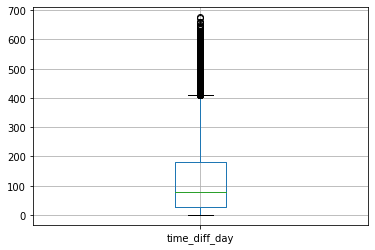

In [ ]:
time_diff_sub.boxplot()

The data is very right skewed. There are a lot of potential outliers (the black, vertical line above the 400 mark on the y-axis).

In this case, it might be more accurate to look at its median rather than its mean.

In [ ]:
day_diff_df = time_diff_sub[['time_diff_day']]
day_diff_df

,time_diff_day
subscriber_id,
956312977043677184,0.000324
1193637934231249660,0.000660
966994241652318208,0.000822
997926306635636736,0.000856
1037700919296843776,0.000972
...,...
966628951689060352,657.449120
1084111313267384320,658.359687
966060145216380928,660.920440


In [ ]:
fig = px.histogram(day_diff_df)
fig.show()

Hover over the graph to see the count for each time between calls in days.

There is a peak at the **5-15 days** interval. This means that for this dataset, most subscribers that called more than once have an average of 5-15 days between their calls.

###**Question 18: Frequency of calls by demographic variables (e.g. gender, education)**

In [ ]:
demographic_calls_df = df[['call_id', 'age', 'gender', 'location', 'location_level_2', 'subscriber_pereferred_language']].copy()
demographic_calls_df.drop_duplicates(inplace=True)

####**Age**

In [ ]:
fig = px.histogram(demographic_calls_df, x='age')
fig.update_xaxes(categoryorder='array', categoryarray= ['under_18', '18_24', '25_34', '35_44', 'over_44'])
fig.show()

####**Gender**

In [ ]:
fig = px.histogram(demographic_calls_df, x='gender')
fig.show()

####**Age + gender**

In [ ]:
demographic_calls_df['age_gender'] = demographic_calls_df['age'] + "," + demographic_calls_df['gender']

In [ ]:
fig = px.histogram(demographic_calls_df, x='age_gender')
fig.update_xaxes(categoryorder='total descending')
fig.show()

####**Location**

In [ ]:
fig = px.histogram(demographic_calls_df, x='location')
fig.update_xaxes(categoryorder='total descending')
fig.show()

####**Location level 2 + Location**

In [ ]:
demographic_calls_df['location_combined'] = demographic_calls_df['location_level_2'] + "," + demographic_calls_df['location']

In [ ]:
fig = px.histogram(demographic_calls_df, x='location_combined')
fig.update_xaxes(categoryorder='total descending')
fig.show()

####**Subscriber preferred language**

In [ ]:
fig = px.histogram(demographic_calls_df, x='subscriber_pereferred_language')
fig.update_xaxes(categoryorder='total descending')
fig.show()

####**Location level 2 + location + subscriber preferred language**

In [ ]:
demographic_calls_df['location_language'] = demographic_calls_df['subscriber_pereferred_language'] + "," + demographic_calls_df['location_combined']

In [ ]:
fig = px.histogram(demographic_calls_df, x='location_language')
fig.update_xaxes(categoryorder='total descending')
fig.show()

###**Question 19: Frequency of duration of calls**

####**Including call durations of 0 second**

In [ ]:
duration_df = df[['call_id', 'duration_listened_minutes', 'duration_listened_seconds']].copy()
duration_df.drop_duplicates(inplace=True)

In [ ]:
duration_df.duration_listened_minutes.describe()

count    98999.000000
mean         0.964161
std          2.313395
min          0.000000
25%          0.000000
50%          0.200000
75%          0.900000
max         45.500000
Name: duration_listened_minutes, dtype: float64

In [ ]:
fig = px.histogram(duration_df, x='duration_listened_minutes')
fig.show()

In [ ]:
duration_df.duration_listened_seconds.describe()

count    98999.000000
mean        57.809735
std        138.766711
min          0.000000
25%          2.000000
50%         14.000000
75%         53.000000
max       2727.000000
Name: duration_listened_seconds, dtype: float64

In [ ]:
fig = px.histogram(duration_df, x='duration_listened_seconds')
fig.show()

A lot of calls are listened to for about 0-4 seconds. There's another small peak in the 65-69 seconds range as well.

The **average (or mean)** duration of calls is **58 seconds**.

The **minimum** time difference between calls is **0 second**.

The **maximum** time difference between calls is **45 minutes 27 seconds**.

The **25th percentile** time difference between calls is **2 seconds**.

The **50th percentile (or median)** time difference between calls is **14 seconds**.

The **75th percentile** time difference between calls is **53 seconds**.

Since the data is right-skewed, it might be better to look at the median rather than the mean.


####**Excluding call durations of 0 second**

In [ ]:
df[df['duration_listened_seconds'] == 0].shape

(18112, 15)

There are 18,112 rows of data that have 0 second for their [duration_listened_seconds]. Personally, I don't think a call that didn't last more than 0 second should be considered a call. The graphs and statistics would probably not differ a lot. But for the sake of analysis, here are the statistics and graph for the data with call durations of 0 second excluded.

In [ ]:
duration_df2 = df[df['duration_listened_seconds'] > 0].copy()
duration_df2.drop_duplicates(inplace=True)

I'm going to assume that the values in the [duration_listened_minutes] column is correct and match the values in the [duration_listened_seconds] column. 

I will now only look at the [duration_listened_seconds] column.

In [ ]:
duration_df2.duration_listened_seconds.describe()

count    80890.000000
mean        70.766547
std        150.526740
min          1.000000
25%          7.000000
50%         21.000000
75%         63.000000
max       2727.000000
Name: duration_listened_seconds, dtype: float64

In [ ]:
fig = px.histogram(duration_df2, x='duration_listened_seconds')
fig.show()

Still, there are a lot of calls are listened to for about 0-4 seconds. There's another small peak in the 65-69 seconds range as well.

The **average (or mean)** duration of calls is **71 seconds**.

The **minimum** time difference between calls is **1 second**.

The **maximum** time difference between calls is **45 minutes 27 seconds**.

The **25th percentile** time difference between calls is **7 seconds**.

The **50th percentile (or median)** time difference between calls is **21 seconds**.

The **75th percentile** time difference between calls is **63 seconds**.

Since the data is right-skewed, it might be better to look at the median rather than the mean. This time, the mean and median are increased as a lot of previous observations with 0 second call durations are removed. 


####**Extra: What are calls in the 2 peaks (<30 seconds and 50<x<80 seconds) about in terms of [block_theme]?**

In [ ]:
group_1 = df[df['duration_listened_seconds'] < 30].copy()
group_1.drop_duplicates(inplace=True)

In [ ]:
group_1.block_theme.value_counts()

                    47543
news                10200
health               4199
ed                   1278
security             1239
health,nutrition      715
gender                506
financial             378
financial,rights      234
games                 219
ag                    121
rights                 93
nutrition               6
Name: block_theme, dtype: int64

Calls that last for less than 30 seconds are mostly about **news**, followed by **health, ed, and security**.

In [ ]:
group_2 = df[(df['duration_listened_seconds'] > 50) & (df['duration_listened_seconds'] < 80 )].copy()
group_2.drop_duplicates(inplace=True)

In [ ]:
group_2.block_theme.value_counts()

news                7961
                    1589
health               883
financial            402
financial,rights     391
rights               367
health,nutrition      67
ag                    57
gender                36
ed                    15
security              13
games                  1
Name: block_theme, dtype: int64

Calls that last for more than 50 seconds but less than 80 seconds are also mostly about **news**, followed by **health, financial, and financial,rights**.

###**Question 20: Time of day distribution of calls**

In [ ]:
hours_calls_df = df[['call_started', 'call_id']].copy()
hours_calls_df = hours_calls_df.drop_duplicates()

In [ ]:
hours_calls_df['time'] = hours_calls_df['call_started'].dt.time
hours_calls_df.drop(columns=['call_started'], inplace=True)

In [ ]:
hours_calls_df[hours_calls_df.duplicated()]

,call_id,time


No duplicates.

In [ ]:
hours_calls_df

,call_id,time
0,1309833640947541204,10:51:15
1,1294603690992787780,10:12:52
2,1241457895032807916,18:30:27
3,1196225677276800020,22:53:46
4,1290352438930891672,16:39:55
...,...,...
99995,1279023524040208144,10:22:51
99996,1325046057033852228,10:19:58
99997,1320890882765417068,23:08:47
99998,1382681849620916320,11:24:01


In [ ]:
hours_calls_df.time.describe()

count        99920
unique       51836
top       20:02:21
freq            11
Name: time, dtype: object

In [ ]:
hours_calls_df.sort_values(by='time', inplace=True)
hours_calls_df

,call_id,time
13653,1378885830596683724,00:00:00
61925,1282490681143125904,00:00:05
53070,1206389238070307604,00:00:07
60002,1300972470660555872,00:00:07
96293,1216173711171315096,00:00:08
...,...,...
31451,1234655436733998380,23:59:54
49862,1275967658831441116,23:59:56
74264,1364027911740908608,23:59:56
38979,1414037444848314108,23:59:58


In [ ]:
hours_calls_df.groupby('time')['call_id'].count().sort_values(ascending=False)

time
20:02:21    11
18:47:00    10
19:22:49    10
18:12:11    10
20:20:06     9
            ..
13:16:24     1
13:16:19     1
13:16:18     1
13:16:14     1
23:59:59     1
Name: call_id, Length: 51836, dtype: int64

From the data above, we can see that: 
- The time **20:02:21** got the **most** unique calls (11 calls in total). 
- The **least** amount of call here is 1. There are several timestamps that have this number of call.
- The **earliest** time we have here is **00:00:00**.
- The **latest** time we have here is **23:59:59**.

In [ ]:
fig = px.histogram(hours_calls_df, x='time')
fig.show()

Hover over the graph above to see the exact count at each timestamp.

It seems like most subscribers called between **7pm - 9pm**.

###**Question 21: Day of week distribution of calls**

In [ ]:
dayofweek_calls_df = df[['call_date', 'call_id']].copy()
dayofweek_calls_df = dayofweek_calls_df.drop_duplicates()

In [ ]:
dayofweek_calls_df['dayofweek'] = dayofweek_calls_df['call_date'].dt.day_name()
dayofweek_calls_df.drop(columns=['call_date'], inplace=True)

In [ ]:
dayofweek_calls_df[dayofweek_calls_df.duplicated()]

,call_id,dayofweek


No duplicates.

In [ ]:
dayofweek_calls_df

,call_id,dayofweek
0,1309833640947541204,Tuesday
1,1294603690992787780,Tuesday
2,1241457895032807916,Tuesday
3,1196225677276800020,Wednesday
4,1290352438930891672,Thursday
...,...,...
99995,1279023524040208144,Monday
99996,1325046057033852228,Tuesday
99997,1320890882765417068,Thursday
99998,1382681849620916320,Sunday


In [ ]:
dayofweek_calls_df.dayofweek.describe()

count         99920
unique            7
top       Wednesday
freq          15345
Name: dayofweek, dtype: object

In [ ]:
cats = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

dayofweek_calls_df['dayofweek'] = pd.Categorical(dayofweek_calls_df['dayofweek'], categories=cats, ordered=True)
dayofweek_calls_df = dayofweek_calls_df.sort_values('dayofweek')
dayofweek_calls_df

,call_id,dayofweek
99999,1248688001304289928,Monday
67223,1365438446709565652,Monday
11548,1248730917951302136,Monday
40162,1362810434407165080,Monday
67213,1246038040120977588,Monday
...,...,...
78813,1220481561024587724,Sunday
7518,1337153488815712284,Sunday
39377,1347273268910418812,Sunday
78962,1248211933736788904,Sunday


In [ ]:
dayofweek_calls_df.groupby('dayofweek')['call_id'].count().sort_values(ascending=False)

dayofweek
Wednesday    15345
Friday       15135
Tuesday      15083
Monday       14967
Thursday     14961
Saturday     12786
Sunday       11643
Name: call_id, dtype: int64

From the data above, we can see that: 
- **Wednesday** got the **most** unique calls (15,345 calls in total). 
- **Sunday** got the **least** number of unique calls (11,643 calls in total).

In [ ]:
fig = px.histogram(dayofweek_calls_df, x='dayofweek')
fig.show()

Hover over the graph above to see the exact count on each weekday.

It seems like most subscribers called between Wednesday - Friday, followed by Monday - Tuesday, and lastly Saturday - Sunday.

###**Extra: Day of month distribution of calls**



In [ ]:
dayofmonth_calls_df = df[['call_date', 'call_id']].copy()
dayofmonth_calls_df = dayofmonth_calls_df.drop_duplicates()

In [ ]:
dayofmonth_calls_df['dayofmonth'] = dayofmonth_calls_df['call_date'].dt.day.values
dayofmonth_calls_df

,call_date,call_id,dayofmonth
0,2021-11-23,1309833640947541204,23
1,2021-10-12,1294603690992787780,12
2,2021-05-18,1241457895032807916,18
3,2021-01-13,1196225677276800020,13
4,2021-09-30,1290352438930891672,30
...,...,...,...
99995,2021-08-30,1279023524040208144,30
99996,2022-01-04,1325046057033852228,4
99997,2021-12-23,1320890882765417068,23
99998,2022-06-12,1382681849620916320,12


In [ ]:
dayofmonth_calls_df.drop(columns=['call_date'], inplace=True)
dayofmonth_calls_df.sort_values(by='dayofmonth', inplace=True)
dayofmonth_calls_df['dayofmonth'] = dayofmonth_calls_df['dayofmonth'].astype(str)
dayofmonth_calls_df

,call_id,dayofmonth
89244,1290615350379473364,1
3446,1268371401850023748,1
41172,1422892167277898928,1
80163,1345484038043394964,1
70784,1235224333216441108,1
...,...,...
21558,1224081240501051752,31
62119,1268097054992296844,31
67994,1202686193411089136,31
42023,1378345782096752056,31


In [ ]:
dayofmonth_calls_df[dayofmonth_calls_df.duplicated()]

,call_id,dayofmonth


No duplicates.

In [ ]:
dayofmonth_calls_df.dayofmonth.describe()

count     99920
unique       31
top           1
freq       3495
Name: dayofmonth, dtype: object

In [ ]:
dayofmonth_calls_df.groupby('dayofmonth')['call_id'].count().sort_values(ascending=False)

dayofmonth
1     3495
21    3468
7     3410
26    3409
2     3390
4     3366
14    3357
12    3347
17    3339
10    3321
3     3315
9     3313
11    3309
19    3306
23    3302
5     3301
16    3281
6     3268
15    3264
8     3242
24    3234
20    3218
27    3213
18    3201
25    3199
22    3196
13    3186
28    3173
29    2874
30    2739
31    1884
Name: call_id, dtype: int64

From the data above, we can see that: 
- The day of month **1** got the **most** unique calls (3,495 calls in total). 
- The day of month **31** got the **least** number of unique calls (1,884 calls in total).

Note that not every month has day of month 29, 30, or 31.

In [ ]:
fig = px.histogram(dayofmonth_calls_df, x='dayofmonth')
fig.show()

Hover over the graph above to see the exact count on each day of month.